In [1]:
import sys
!{sys.executable} -m pip install torch==1.10.2+cu113 torchvision==0.11.3+cu113 torchaudio==0.10.2+cu113 -f https://download.pytorch.org/whl/cu113/torch_stable.html -q
!{sys.executable} -m pip install torch -q
!{sys.executable} -m pip install torchvision -q
!{sys.executable} -m pip install pytorch_lightning -q
!{sys.executable} -m pip install pytorch-lightning -q
!{sys.executable} -m pip install shap -q
!{sys.executable} -m pip install xgboost -q

In [2]:
from sklearn.model_selection import train_test_split
import xgboost
import shap
import numpy as np
import matplotlib.pylab as pl
import matplotlib.pyplot as plt
import math
import seaborn as sns
import pickle

# Using make_column_transformer to One-Hot Encode
from sklearn.preprocessing import OneHotEncoder
from sklearn.compose import make_column_transformer
from seaborn import load_dataset
import pandas as pd

# print the JS visualization code to the notebook
shap.initjs()


def print_txt(msg: str):
    print(msg, end = '\r')
    text_file = open("Outputs/shap.txt", "w")
    text_file.write(msg)
    text_file.close()


#randomly reduce the two larger dfs to fit size of high elo
    

In [3]:
viz_path = 'Visualizations/XGBOOST/'
global tf



In [4]:
tf = 0

In [5]:
import logging
logging.basicConfig(filename='xb_boost.log',  level=logging.DEBUG)
logger = logging.getLogger(__name__)

global last_data
last_data = "init"
global last_epoch 
last_epoch ="init"
global log_dict
log_dict = {}

import xgboost

class XGBLogging(xgboost.callback.TrainingCallback):
    """log train logs to file"""

    def __init__(self, epoch_log_interval=10):
        self.epoch_log_interval = epoch_log_interval    
        self.log_dict = {}
        self.last_value = "init"
        self.last_epoch = "init"
        self.score_types = ['weight','gain','cover','total_gain','total_cover']
        
    def after_iteration(self, model, epoch, evals_log):
        if epoch % self.epoch_log_interval == 0:
            for data, metric in evals_log.items():
                metrics = list(metric.keys())
                metrics_str = ""
                for m_key in metrics:
                    metrics_str = metrics_str + f"{m_key}: {metric[m_key][-1]}"
                logger.info(f"TF: {tf} - Epoch: {epoch}, {data}: {metrics_str}")
                
                self.log_dict[epoch] = metrics_str
                self.last_value = metrics_str
                self.last_epoch = epoch
                
        #last_data = evals_log.items()
        #last_epoch = epoch
        # False to indicate training should not stop.
        return False
    
    def after_training(self,model):
        log_dict[tf]= self.log_dict
        log_dict[tf]['final_value'] = self.last_value 
        log_dict[tf]['final_epoch'] = self.last_epoch
        log_dict[tf]['f_scores'] = model.get_fscore()
        for score_type in self.score_types:
            log_dict[tf][score_type] = model.get_score(importance_type=score_type)

        
        #output = open(f'data/minn/logs/log_dict_tf{tf}.pkl' , 'wb')
        #pickle.dump(log_dict, output)
        #output.close()
        
        return model

Load Dataset

In [6]:
incomplete_info = True
elo = 'all'
setting = '2p_augmented_full_5000_elo_'



#get col names 
#available columns
with open('masterdata/tab_data_cols.pkl', 'rb') as f:
        init_cols = pickle.load(f)
        
#actually used columns
init_cols.remove('match_id')
#init_cols.remove('time')
#init_cols.remove('winner')
init_cols.remove('duration')
#init_cols.remove('p1_civ')
#init_cols.remove('p2_civ')
init_cols.remove('map')
init_cols.remove('map_size')
init_cols.remove('imgf_Move_layer')
init_cols.append('avg_elo')
#init_cols.append('p1_elo')

In [7]:
time_list = [t for t in range(0,5001,120)]
scenarios = [1,2]

elo_list = ['all','low','medium','high']#
subsample = 0.9#subsamples = [0.1,0.2,0.4,0.5,0.6,0.8,0.9,1] #init 0.5 #default 1
eta = 0.15#etas = [0.01,0.05,0.08,0.1,0.12,0.15,0.3,] #init 0.01 default 0.3
#max values =
#eta :0.15	sumsamples = 0.9

In [8]:
with open('data/minn/elo_all/recordfile_tab_data_0.pkl', 'rb') as f:
    raw_full_tab_data = pickle.load(f)
raw_full_tab_data

,match_id,avg_elo,time,map,map_size,duration,p1_civ,p2_civ,winner,p1 Feudal Age Time,...,p2_Carrack,p2_Greek Fire,p2_Elite Caravel,p2_Elite Elephant Archer,p2_Great Wall,p2_Heavy Demolition Ship,p2_Cuman Mercenaries,p2_Madrasah,p2_Silk Road,p2_Elite Turtle Ship
50453403_0,50453403,1104.0,0,Arabia,Tiny,3445,Vikings,Mayans,0,0,...,0,0,0,0,0,0,0,0,0,0
64335748_0,64335748,1080.0,0,Arabia,Tiny,851,Mayans,Magyars,1,0,...,0,0,0,0,0,0,0,0,0,0
116883036_0,116883036,1050.0,0,Arabia,Tiny,4737,Berbers,Slavs,1,0,...,0,0,0,0,0,0,0,0,0,0
125287851_0,125287851,1672.5,0,Arabia,Tiny,2899,Vikings,Mayans,0,0,...,0,0,0,0,0,0,0,0,0,0
107928939_0,107928939,1135.0,0,Arabia,Tiny,1824,Chinese,Japanese,1,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
112101795_0,112101795,1236.0,0,Arabia,Tiny,1917,Franks,Franks,0,0,...,0,0,0,0,0,0,0,0,0,0
137272191_0,137272191,1540.0,0,Arabia,Tiny,2525,Mongols,Byzantines,1,0,...,0,0,0,0,0,0,0,0,0,0
124942713_0,124942713,870.5,0,Arabia,Tiny,4243,Bulgarians,Ethiopians,1,0,...,0,0,0,0,0,0,0,0,0,0
141486159_0,141486159,1234.5,0,Arabia,Tiny,3280,Turks,Indians,1,0,...,0,0,0,0,0,0,0,0,0,0


In [9]:
global glob_log_dict
glob_log_dict = {}
for scenario in scenarios:
    for elo in elo_list:
        glob_log_dict[elo] = {}
        for tf in time_list:
            print_txt(f'Start TF {tf} - ELO: {elo}')
            log_dict[tf] = {}
            logger.info(f'************* Starting TF {tf} ***************')

            #define parameters
            data_path = f"data/minn/elo_{elo}/"
            filename = f"recordfile_tab_data_{tf}.pkl"

                #load raw data
            with open(data_path + filename, 'rb') as f:
                    raw_full_tab_data = pickle.load(f)[init_cols]
            
            raw_full_tab_data = raw_full_tab_data.sample(n=13922)
            #init vars
            perspectives = [0,1]       
            p_dfs = {}

            #augment data
            for p in perspectives:

                #define perspective
                if p==0:
                    player = 'p1'
                    opp = 'p2'
                else:
                    player = 'p2'
                    opp = 'p1'

                opp_cols = []
                opp_rename_dict = {}

                player_cols = []
                player_rename_dict = {}

                rest_cols = []


                for col in init_cols:
                    if player in col:
                        new_col = col.replace(player,'player')
                        player_cols.append(new_col)
                        player_rename_dict[col] = new_col

                    elif opp in col:
                        new_col = col.replace(opp,'opp')
                        opp_cols.append(new_col)
                        opp_rename_dict[col] = new_col

                    else: rest_cols.append(col)

                all_cols = player_cols + opp_cols + rest_cols

                #rename cols in perspective dataframe
                p_dfs[p] = raw_full_tab_data.copy()
                p_dfs[p].rename(columns=player_rename_dict,inplace=True)
                p_dfs[p].rename(columns=opp_rename_dict,inplace=True)

                #create winner bol
                p_dfs[p]["winner"]  = np.where(p_dfs[p]['winner']==p, True, False)
                #p_dfs[p].drop(columns=['winner'],inplace=True)


            #concat dataframes        
            full_tab_data = pd.concat([p_dfs[0],p_dfs[1]])

            #if only 1p perspective, remove opp cols:
            if scenario == 1:
                used_cols = all_cols
                keep_list = ['opp_civ']

                #delete opp info
                for col in opp_cols:
                    if col not in keep_list:
                        used_cols.remove(col)
                full_tab_data = full_tab_data[used_cols]


            #define X and y for Model
            X = full_tab_data.drop(columns=['winner'])
            y = full_tab_data["winner"].to_numpy()


            # Using make_column_transformer to One-Hot Encode
            transformer = make_column_transformer(
                (OneHotEncoder(), ['player_civ','opp_civ']),
                remainder='passthrough')

            transformed = transformer.fit_transform(X)
            transformed_df = pd.DataFrame(
                transformed, 
                columns=transformer.get_feature_names_out()
            )
            X = transformed_df

            # create a train/test split
            X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=7)
            d_train = xgboost.DMatrix(X_train, label=y_train, enable_categorical=True)
            d_test = xgboost.DMatrix(X_test, label=y_test, enable_categorical=True)


            #setup model
            params = {
                "eta": eta, #was 0.01
                "objective": "binary:logistic",
                "subsample": subsample,
                "base_score": np.mean(y_train),
                "eval_metric": "error",
                "n_jobs": 56
            }
            model = xgboost.train(params, d_train, 5000, evals = [(d_test, "test")], verbose_eval=100, early_stopping_rounds=20,callbacks = [XGBLogging(epoch_log_interval=10)])



            #viz
            name = f"xgboost_imp_tf_{tf}"


            g= xgboost.plot_importance(model, max_num_features=20)
            #g.set(aspect=5000)
            plt.title(f"xgboost.plot_importance - ELO {elo} - TF {tf} - Type: Gain")
            plt.tight_layout()
            plt.savefig(viz_path+name)
            #plt.show()


        #output = open(f'data/minn/logs/{setting}_{elo}_final_log_dict.pkl' , 'wb')
        #pickle.dump(log_dict, output)
        #output.close()

            glob_log_dict[elo] = log_dict.copy()
            output = open(f'data/minn/logs/{scenario}P_global_log_dict_subsample.pkl' , 'wb')
            pickle.dump(glob_log_dict, output)
            output.close()

[0]	test-error:0.47908
[20]	test-error:0.48267
[0]	test-error:0.47728l
[50]	test-error:0.48267
[0]	test-error:0.46938l
[37]	test-error:0.47046
[0]	test-error:0.46741l
[29]	test-error:0.45933
[0]	test-error:0.45089l
[31]	test-error:0.44119
[0]	test-error:0.44209l
[46]	test-error:0.44478
[0]	test-error:0.44263l
[36]	test-error:0.41641
[0]	test-error:0.43724l
[80]	test-error:0.41192
[0]	test-error:0.44065l
[61]	test-error:0.41156
[0]	test-error:0.41839ll
[48]	test-error:0.39289
[0]	test-error:0.41731ll
[46]	test-error:0.38337
[0]	test-error:0.42000ll
[61]	test-error:0.38265
[0]	test-error:0.40869ll
[59]	test-error:0.37350
[0]	test-error:0.43006ll
[31]	test-error:0.37026
[0]	test-error:0.41569ll
[61]	test-error:0.35644
[0]	test-error:0.40923ll
[74]	test-error:0.34010
[0]	test-error:0.41695ll
[100]	test-error:0.34243
[135]	test-error:0.34333
[0]	test-error:0.40474ll
[98]	test-error:0.34387
[0]	test-error:0.39325ll
[68]	test-error:0.34584
[0]	test-error:0.39576ll
[71]	test-error:0.33238
[0]	

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


[0]	test-error:0.39181
[100]	test-error:0.32394
[118]	test-error:0.32681
[0]	test-error:0.39038ll
[89]	test-error:0.33256
[0]	test-error:0.38319ll
[86]	test-error:0.31657
[0]	test-error:0.38319ll
[83]	test-error:0.32178
[0]	test-error:0.37314ll
[85]	test-error:0.31352
[0]	test-error:0.37206ll
[58]	test-error:0.30760
[0]	test-error:0.37870ll
[100]	test-error:0.31316
[164]	test-error:0.30813
[0]	test-error:0.37888ll
[67]	test-error:0.30957
[0]	test-error:0.37565ll
[82]	test-error:0.32250
[0]	test-error:0.37493ll
[73]	test-error:0.31137
[0]	test-error:0.37691ll
[95]	test-error:0.31011
[0]	test-error:0.36631ll
[75]	test-error:0.31837
[0]	test-error:0.36883ll
[58]	test-error:0.30221
[0]	test-error:0.36811ll
[100]	test-error:0.31280
[136]	test-error:0.31226
[0]	test-error:0.37583ll
[97]	test-error:0.32070
[0]	test-error:0.37529ll
[100]	test-error:0.30544
[179]	test-error:0.29880
[0]	test-error:0.37457ll
[100]	test-error:0.30257
[165]	test-error:0.29772
[0]	test-error:0.36937ll
[95]	test-erro

Train the model

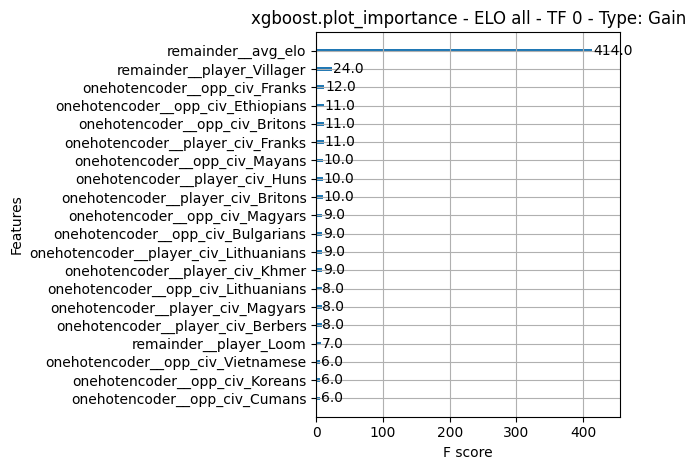

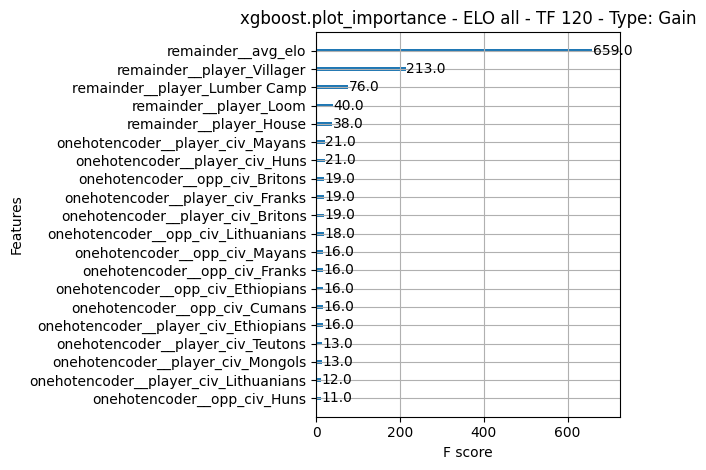

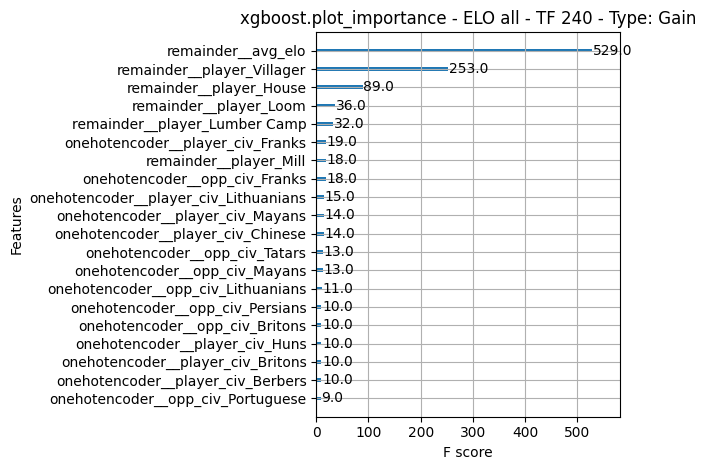

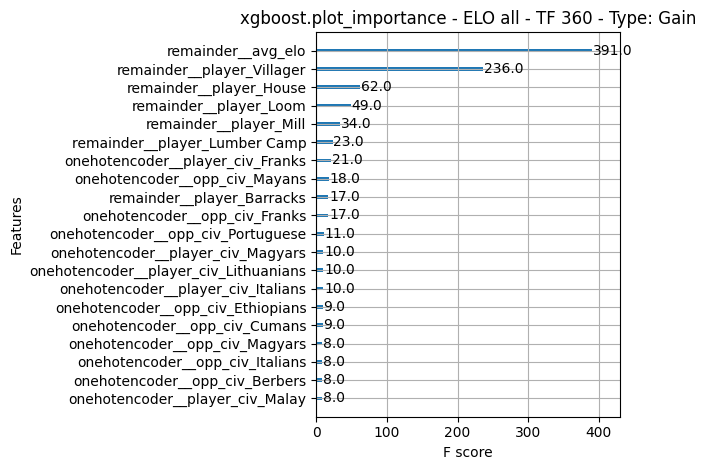

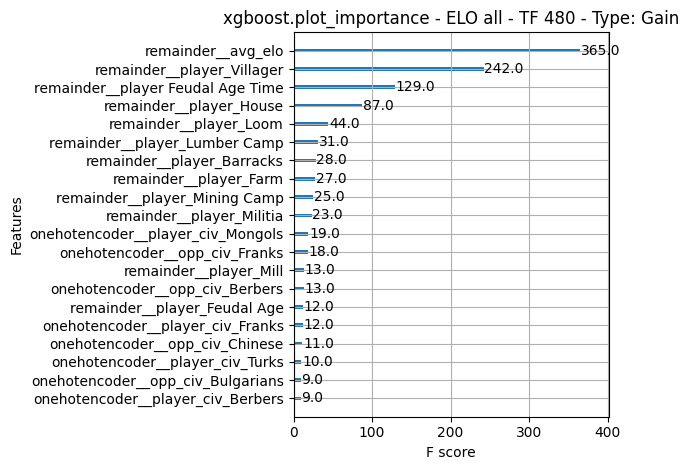

...

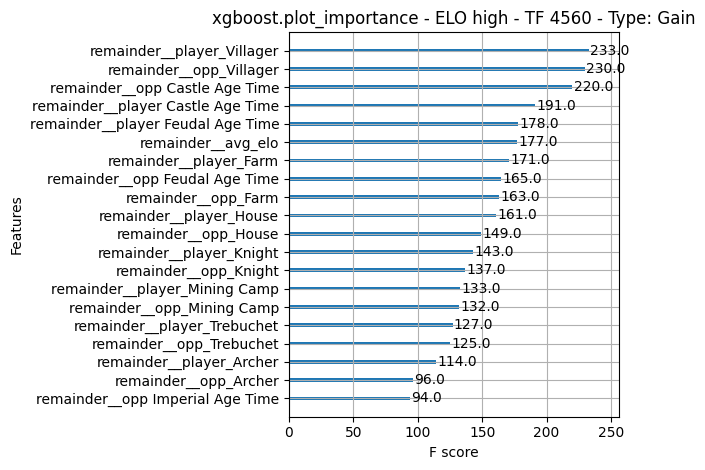

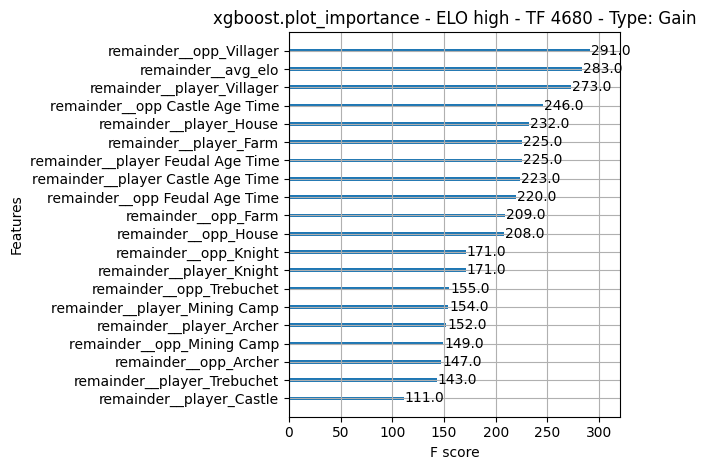

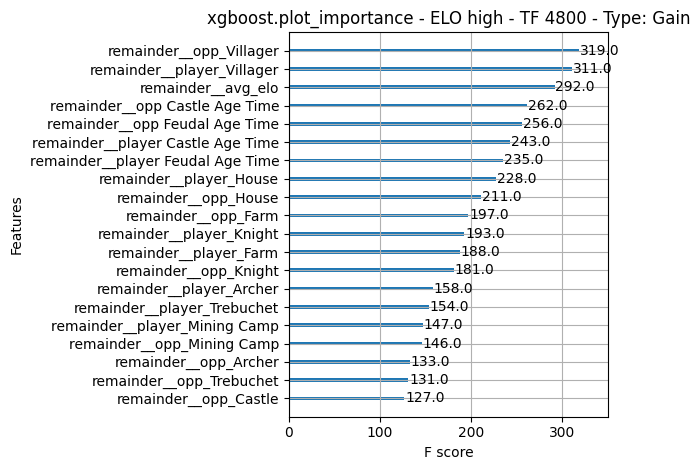

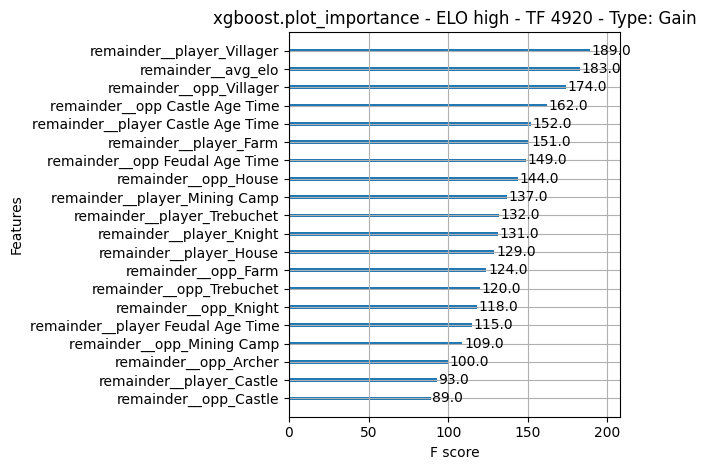

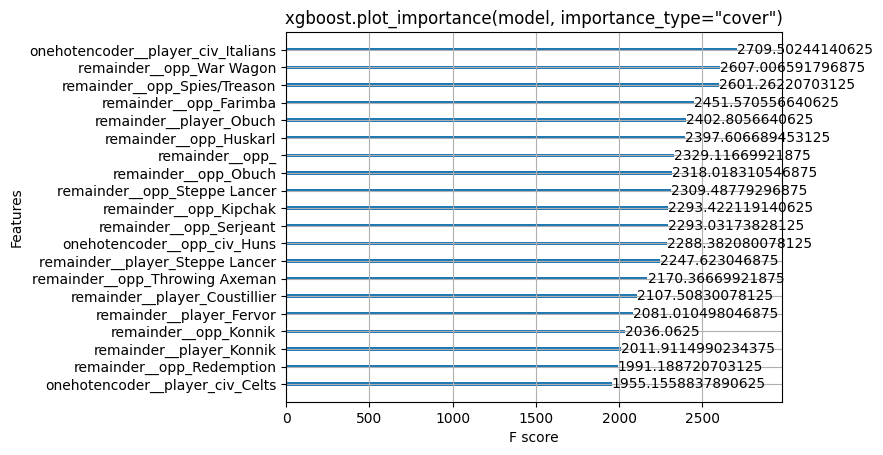

In [10]:
xgboost.plot_importance(model, max_num_features=20, importance_type="cover")
pl.title('xgboost.plot_importance(model, importance_type="cover")')
pl.show()

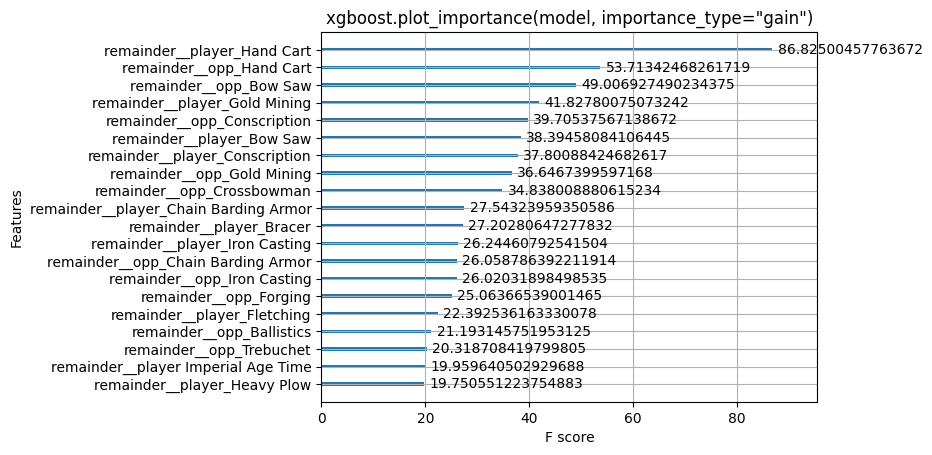

In [11]:
xgboost.plot_importance(model, max_num_features=20, importance_type="gain")
pl.title('xgboost.plot_importance(model, importance_type="gain")')
pl.show()

In [12]:

#shap.summary_plot(shap_values, X_test)

Explain predictions

In [13]:
# this takes a minute or two since we are explaining over 30 thousand samples in a model with over a thousand trees
explainer = shap.TreeExplainer(model)
shap_values = explainer.shap_values(X)

In [14]:
#shap.force_plot(explainer.expected_value, shap_values[:20,:], X.iloc[:20,:])

In [15]:
shap_values

array([[ 2.34688283e-03, -1.42509452e-04,  0.00000000e+00, ...,
         0.00000000e+00,  0.00000000e+00,  1.10914344e-02],
       [ 1.33409048e-04, -4.06715350e-04,  0.00000000e+00, ...,
         0.00000000e+00,  0.00000000e+00, -3.19367349e-02],
       [ 2.14190339e-04, -1.09369738e-03,  0.00000000e+00, ...,
         0.00000000e+00,  0.00000000e+00, -2.60008126e-02],
       ...,
       [ 2.18056230e-04, -1.05304105e-04,  0.00000000e+00, ...,
         0.00000000e+00,  0.00000000e+00, -2.74547469e-03],
       [ 9.71702830e-05, -1.42509452e-04,  0.00000000e+00, ...,
         0.00000000e+00,  0.00000000e+00, -6.06313627e-03],
       [ 1.30242493e-04, -2.24161777e-04,  0.00000000e+00, ...,
         0.00000000e+00,  0.00000000e+00,  1.48670143e-03]], dtype=float32)

In [16]:
explainer